<a href="https://colab.research.google.com/github/Limmaji/age_gender_model/blob/main/age%2Bgender%2Byolo%2Bmediapipe_mp4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
%cd '/content/drive/MyDrive/Colab Notebooks/23.12.18딥러닝/최종프로젝트_모델링'

/content/drive/MyDrive/Colab Notebooks/23.12.18딥러닝/최종프로젝트_모델링


In [ ]:
!pip install git+https://github.com/ultralytics/ultralytics.git

  Cloning https://github.com/ultralytics/ultralytics.git to /tmp/pip-req-build-u3v6sv_s
  Running command git clone --filter=blob:none --quiet https://github.com/ultralytics/ultralytics.git /tmp/pip-req-build-u3v6sv_s
  Resolved https://github.com/ultralytics/ultralytics.git to commit 2d75f72598d5ce80786be61f140673a6d1dd7e57
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.1.18-py3-none-any.whl size=716104 sha256=3ba94519da49071cd3b6616649ce857035ef62e7e8613d12c9b414a154f1e4d4
  Stored in directory: /tmp/pip-ephem-wheel-cache-5utafnl9/wheels/45/25/b9/9f1e3857f58c296e7854ef871c3f5a15d519cc6c679848df8e
Successfully built ultralytics


In [ ]:
!pip install ultralytics

In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.8/34.8 MB 48.3 MB/s eta 0:00:00


# 나이 성별 yolo 모델 합치기

In [8]:
import cv2
import dlib
import numpy as np
from keras.models import load_model
from keras.preprocessing.image import img_to_array
from keras.applications.mobilenet_v2 import preprocess_input
from google.colab.patches import cv2_imshow
# from ultralytics import YOLO

# dlib 초기화
detector = dlib.get_frontal_face_detector()


# 나이 및 성별 예측 모델 로드
age_model = load_model('./model/model1048_05_0.481.hdf5')  # 나이 모델 로드
gender_model = load_model('./model/model2_02_0.854.hdf5')  # 성별 모델 로드

def preprocess_image(image):
    # 이미지 전처리
    try :
      image = cv2.resize(image, (224, 224))
      image = img_to_array(image)
      image = preprocess_input(image)
      image = np.expand_dims(image, axis=0)
    except :
      break

  return image



# 함수 정의
def predict_age(model, input_image):
    # 예측을 위해 이미지를 적절한 형식으로 전처리
    input_image = preprocess_image(input_image)

    # 모델에 이미지 전달하여 예측 수행
    age_prediction = model.predict(input_image)

    # 예측 결과 반환
    return age_prediction

def predict_gender(model, input_image):
    # 예측을 위해 이미지를 적절한 형식으로 전처리
    input_image = preprocess_image(input_image)

    # 모델에 이미지 전달하여 예측 수행
    gender_prediction = model.predict(input_image)

    # 예측 결과 반환
    return gender_prediction

# 카메라 열기 (CCTV 영상 대신 카메라를 사용할 수도 있음)
cap = cv2.VideoCapture('./model/cctv2.mp4')  # CCTV 영상 파일 경로 입력

while True:
    ret, frame = cap.read()

    # 얼굴 감지
    faces = detector(frame)

    for face in faces:
        x, y, w, h = (face.left(), face.top(), face.width(), face.height())

        # 추출된 얼굴 영역
        face_image = frame[y:y+h, x:x+w]

        # 나이 예측
        age_predictions = predict_age(age_model, face_image)
        predicted_age_index = np.argmax(age_predictions)
        predicted_age = predicted_age_index * 10 + 10  # 인덱스를 나이로 변환
        age_accuracy = np.max(age_predictions)  # 나이 예측 정확도

        # 성별 예측
        gender_predictions = predict_gender(gender_model, face_image)
        predicted_gender_index = np.argmax(gender_predictions)

        gender_accuracy = np.max(gender_predictions)  # 성별 예측 정확도

        # 얼굴에 박스 그리기
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # 나이 및 성별 출력
        predicted_gender = 'f' if predicted_gender_index == 0 else 'm'
        text = f"age: {predicted_age}, gender: {predicted_gender}, acc: {age_accuracy * 100:.2f}% / {gender_accuracy * 100:.2f}%"
        cv2.putText(frame, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

    # 화면에 표시
    cv2_imshow(frame)

    # 종료 키: 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 작업 완료 후 해제
cap.release()
cv2.destroyAllWindows()


KeyboardInterrupt: 


0: 544x960 1 face, 45.5ms
Speed: 4.2ms preprocess, 45.5ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 135ms/step


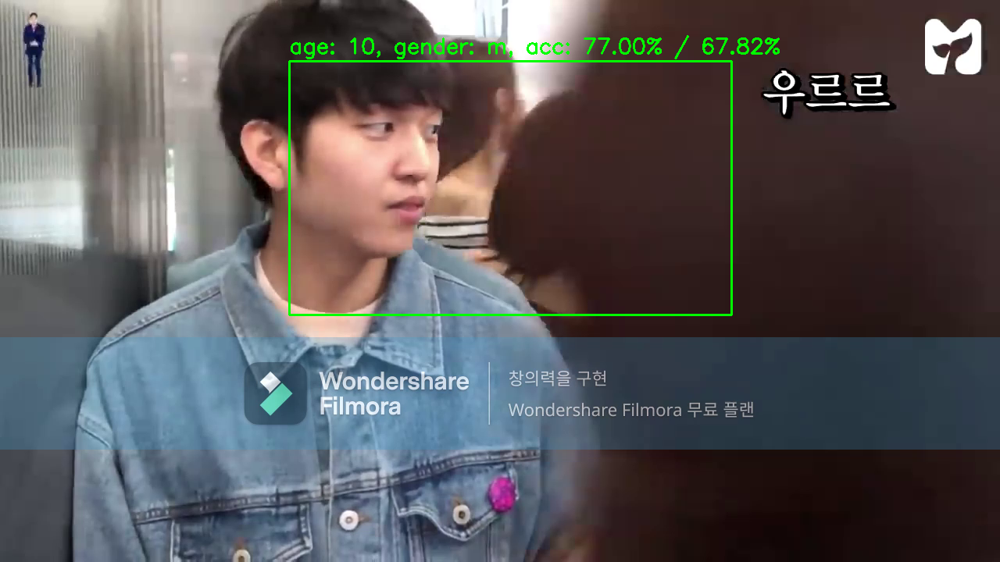


0: 544x960 1 face, 40.1ms
Speed: 3.9ms preprocess, 40.1ms inference, 3.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


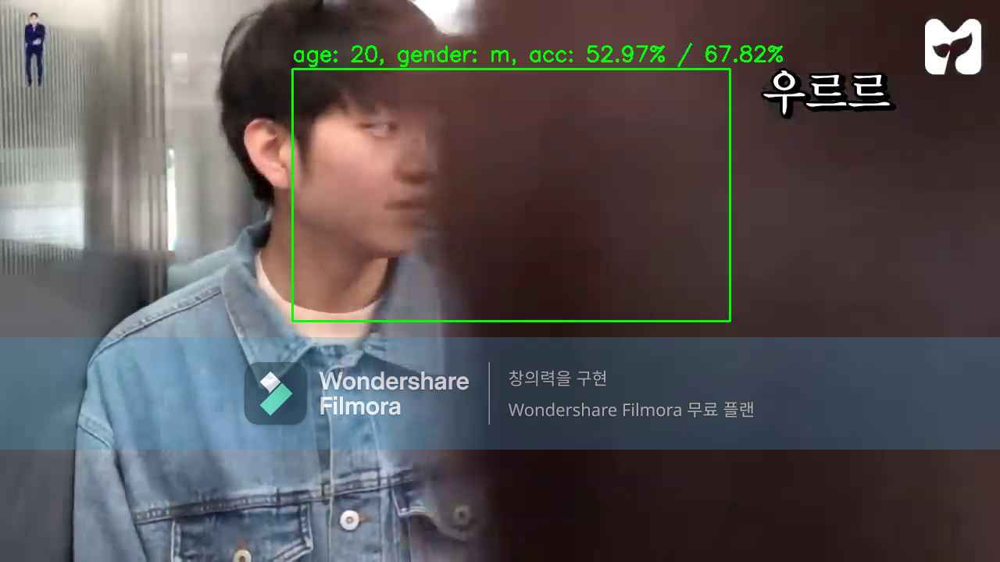


0: 544x960 1 face, 39.8ms
Speed: 4.0ms preprocess, 39.8ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


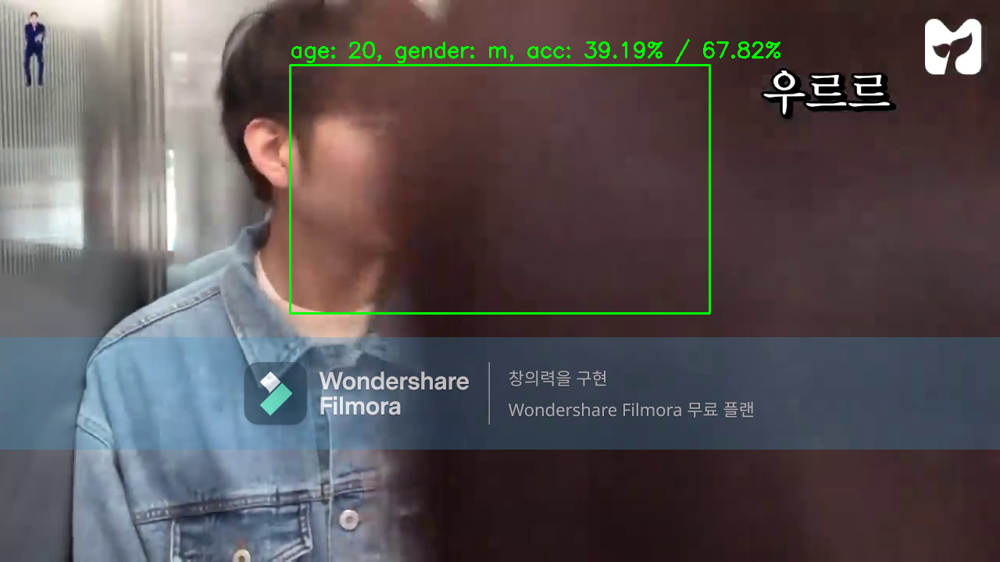


0: 544x960 (no detections), 39.6ms
Speed: 5.4ms preprocess, 39.6ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 960)


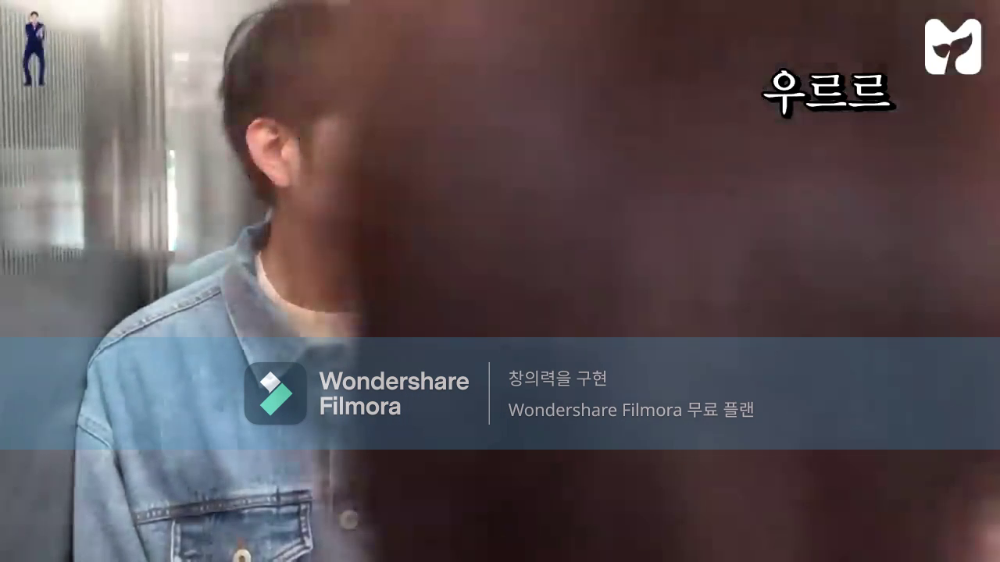


0: 544x960 (no detections), 39.6ms
Speed: 5.4ms preprocess, 39.6ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 960)


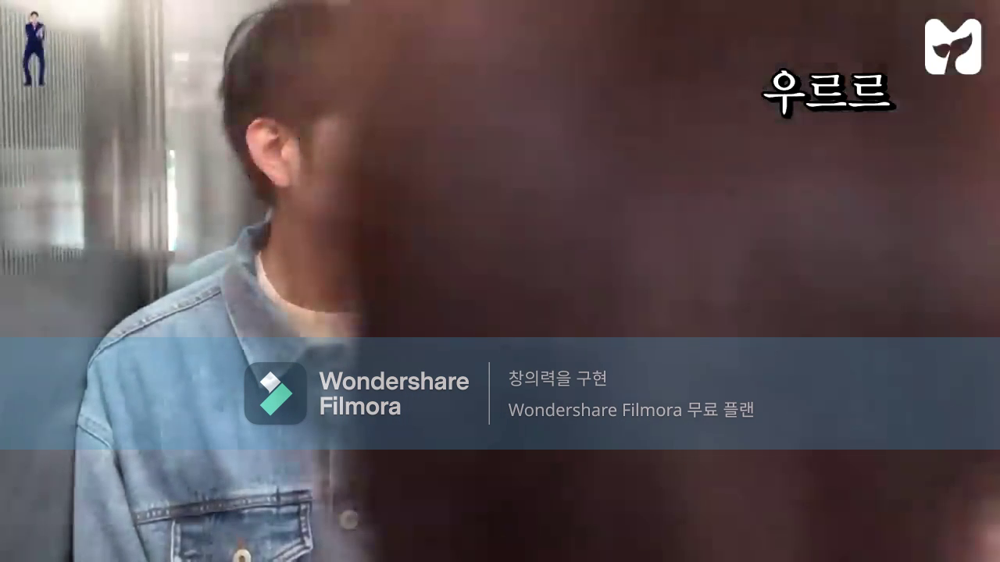


0: 544x960 (no detections), 39.5ms
Speed: 4.0ms preprocess, 39.5ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 960)


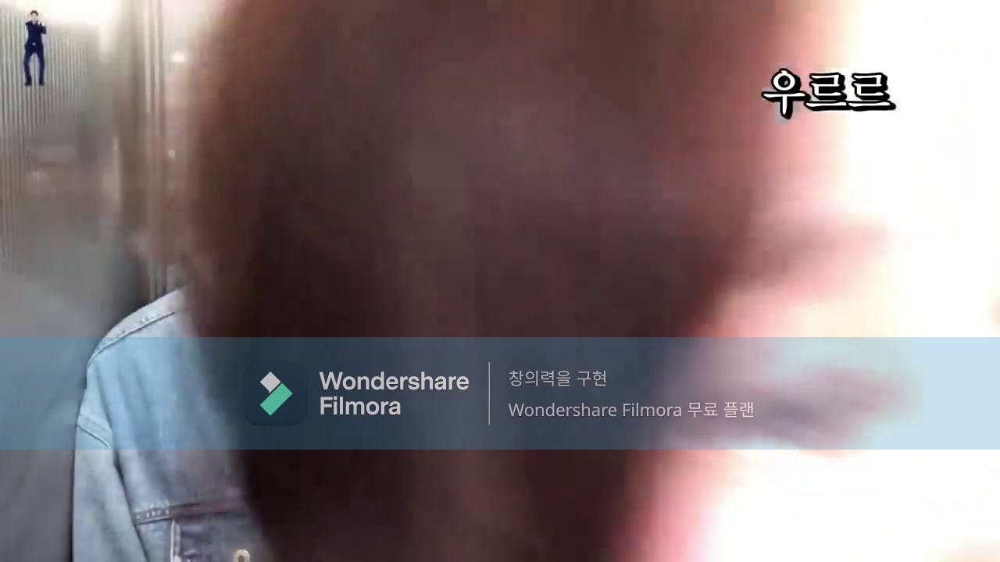


0: 544x960 (no detections), 44.6ms
Speed: 5.4ms preprocess, 44.6ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 960)


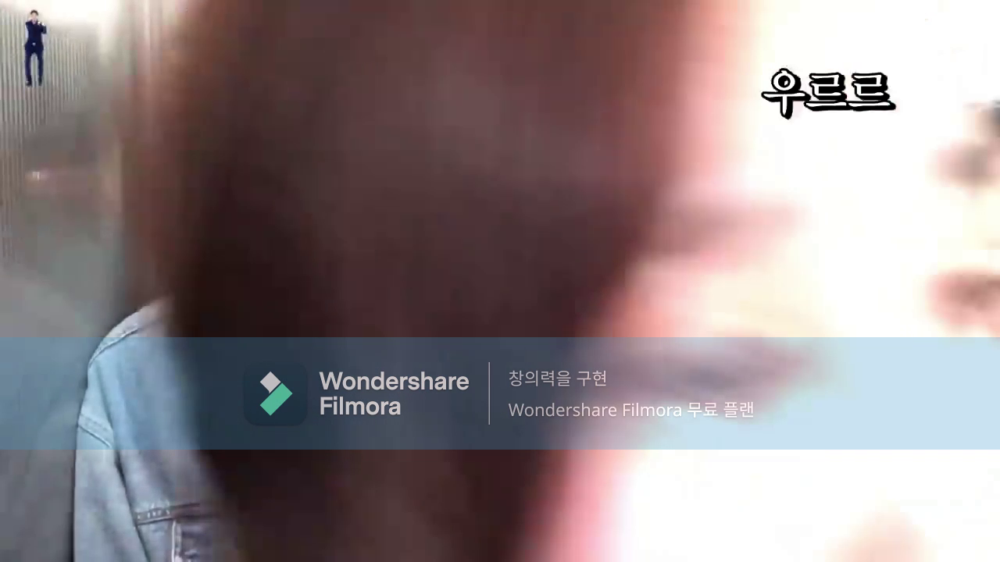


0: 544x960 1 face, 44.7ms
Speed: 5.6ms preprocess, 44.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


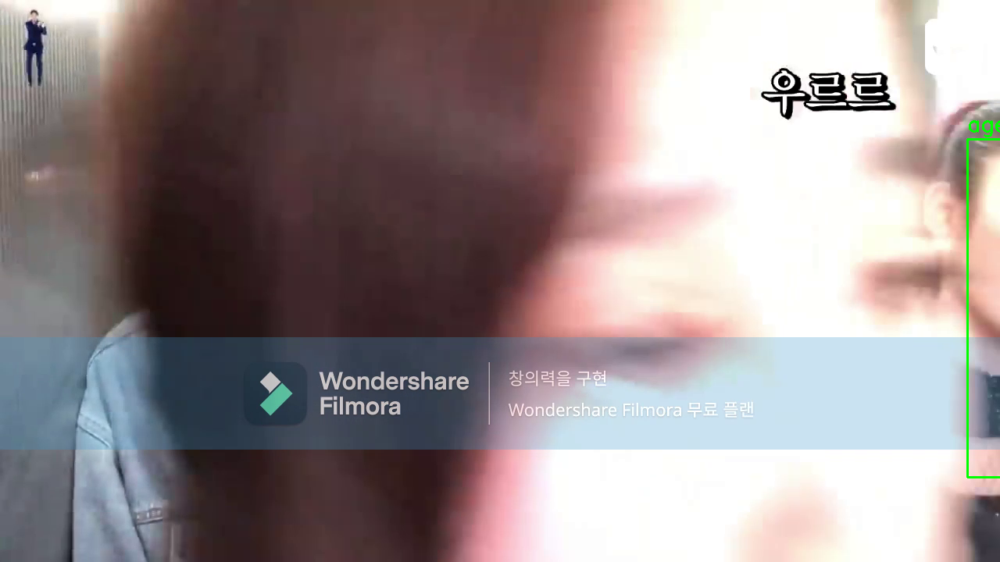


0: 544x960 6 faces, 45.0ms
Speed: 4.0ms preprocess, 45.0ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


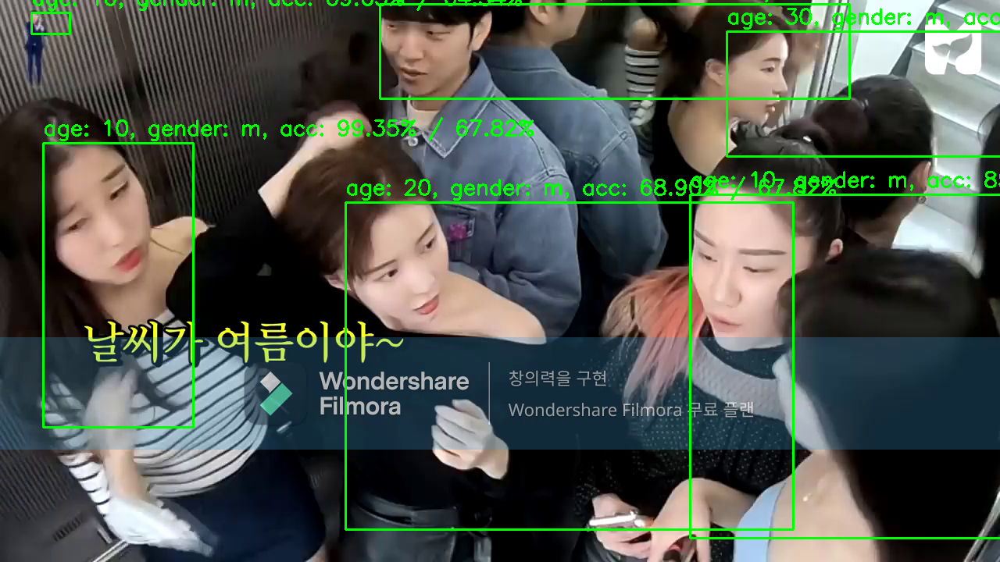


0: 544x960 6 faces, 45.0ms
Speed: 5.3ms preprocess, 45.0ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


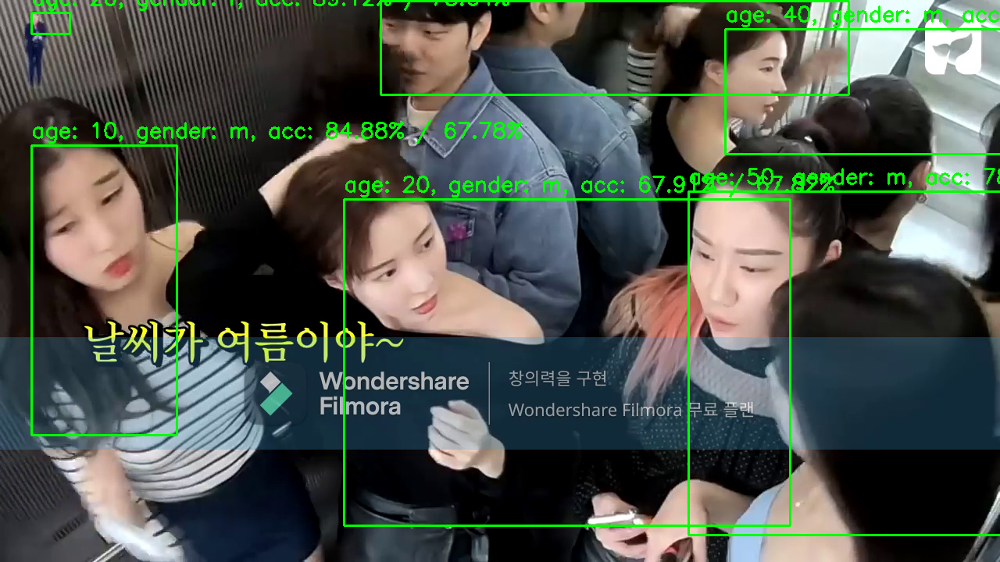


0: 544x960 6 faces, 44.7ms
Speed: 3.8ms preprocess, 44.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


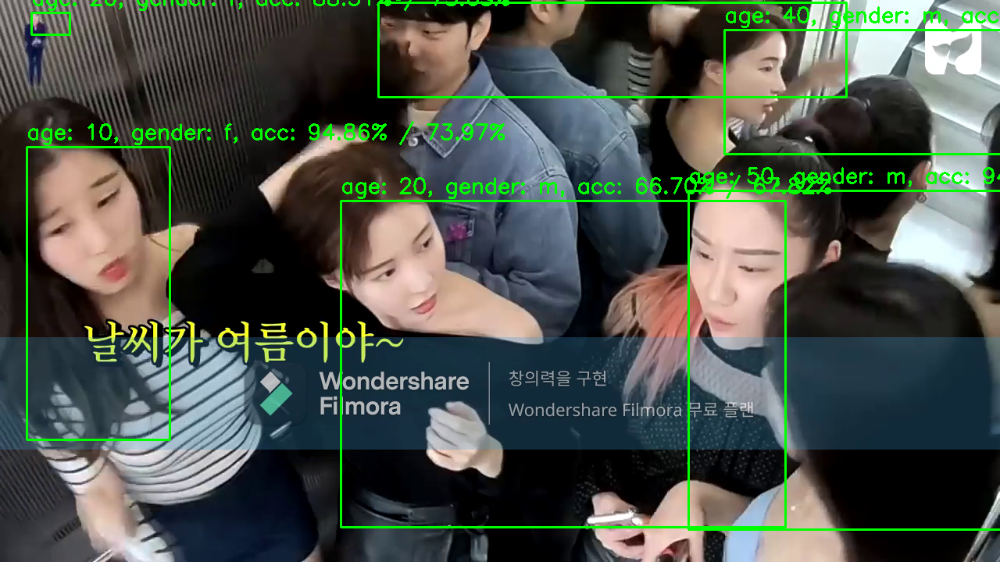


0: 544x960 6 faces, 44.9ms
Speed: 4.6ms preprocess, 44.9ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


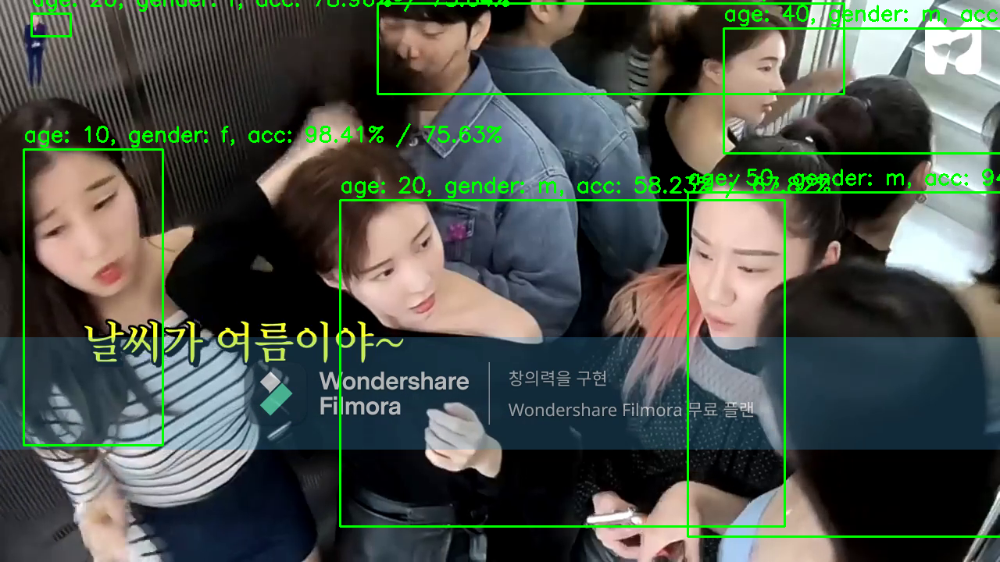


0: 544x960 6 faces, 44.7ms
Speed: 4.2ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


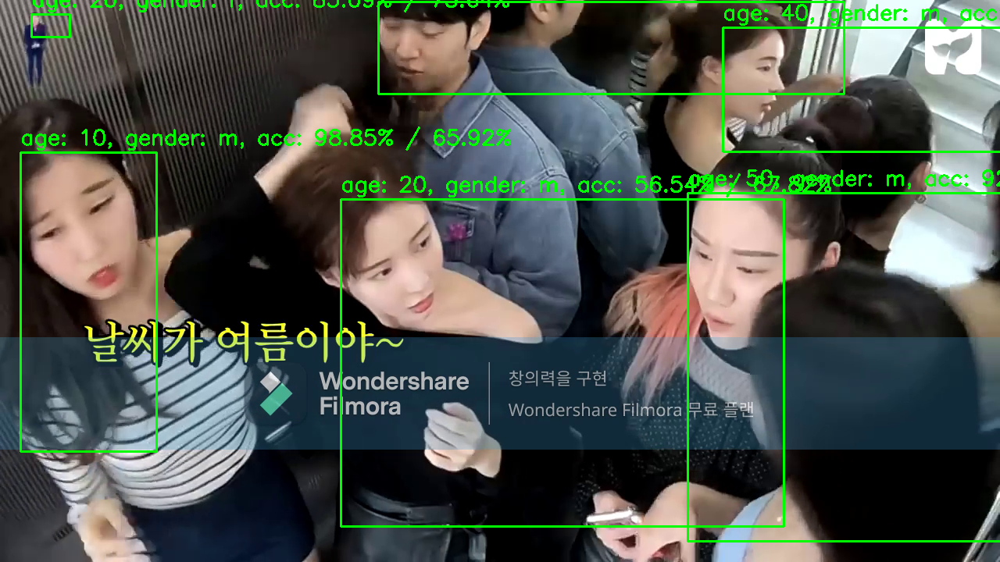


0: 544x960 6 faces, 44.7ms
Speed: 5.3ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


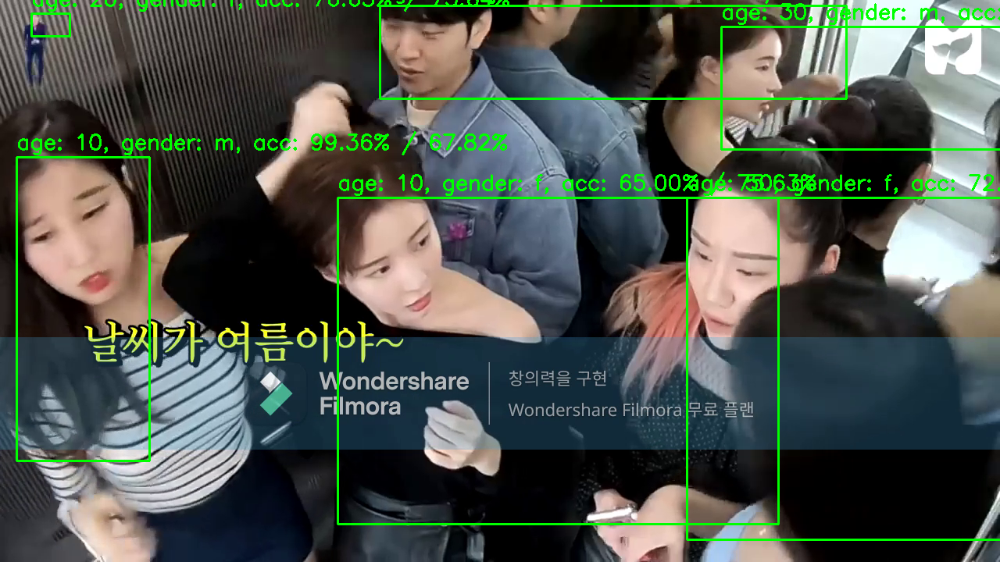


0: 544x960 7 faces, 44.7ms
Speed: 4.0ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


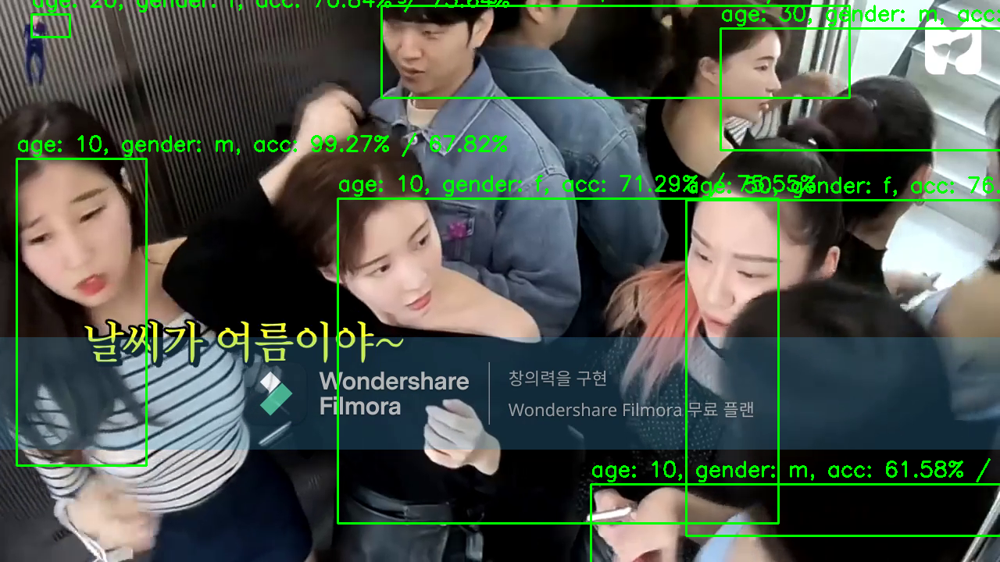


0: 544x960 7 faces, 44.8ms
Speed: 4.0ms preprocess, 44.8ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


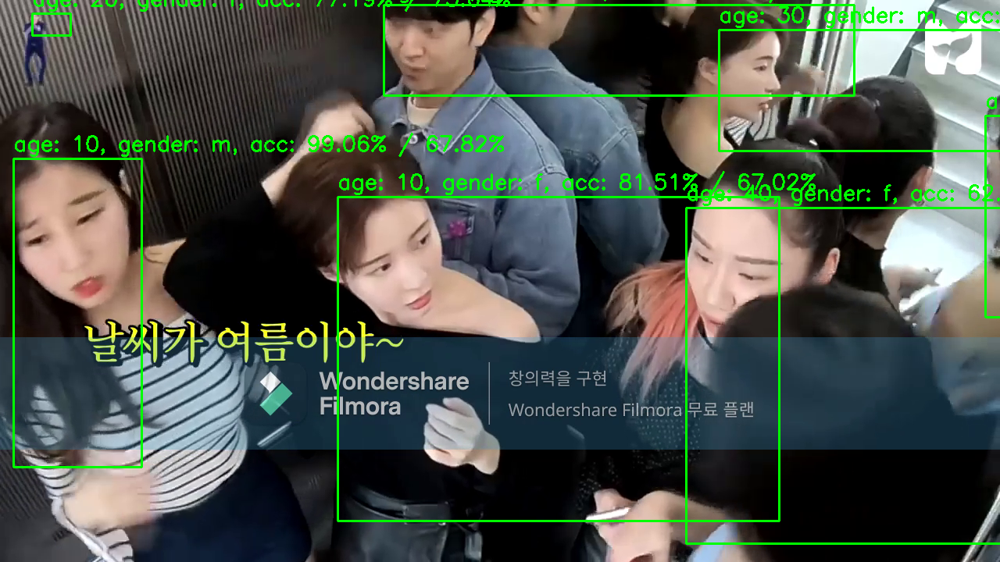


0: 544x960 6 faces, 44.7ms
Speed: 3.9ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


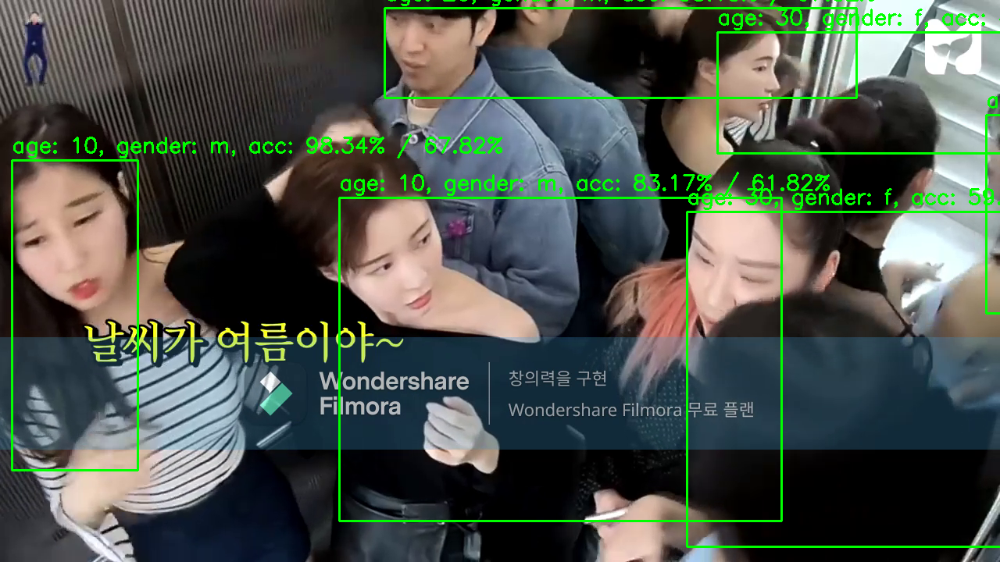


0: 544x960 7 faces, 44.9ms
Speed: 3.7ms preprocess, 44.9ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


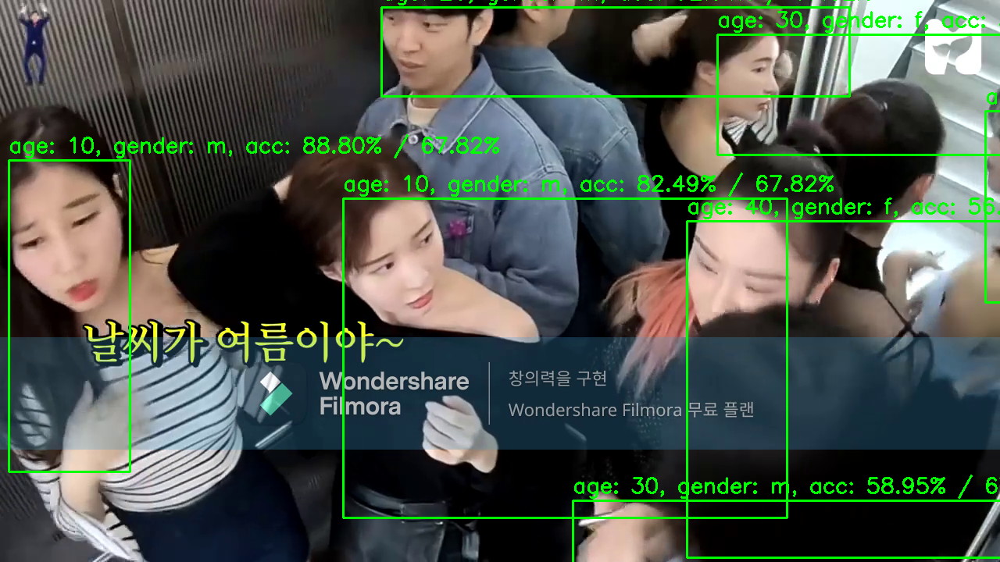


0: 544x960 7 faces, 44.9ms
Speed: 4.5ms preprocess, 44.9ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


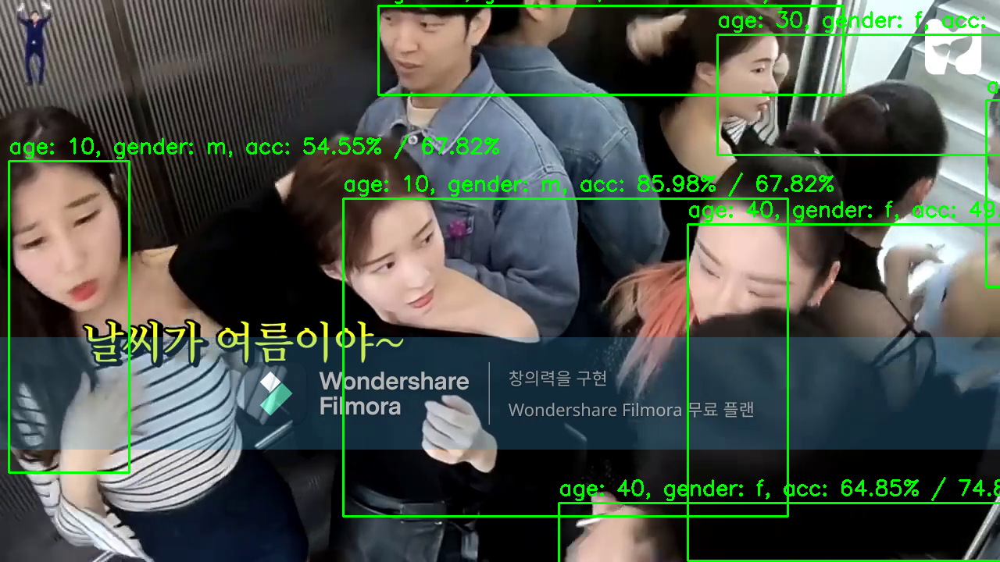


0: 544x960 6 faces, 45.0ms
Speed: 4.4ms preprocess, 45.0ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 23ms/step


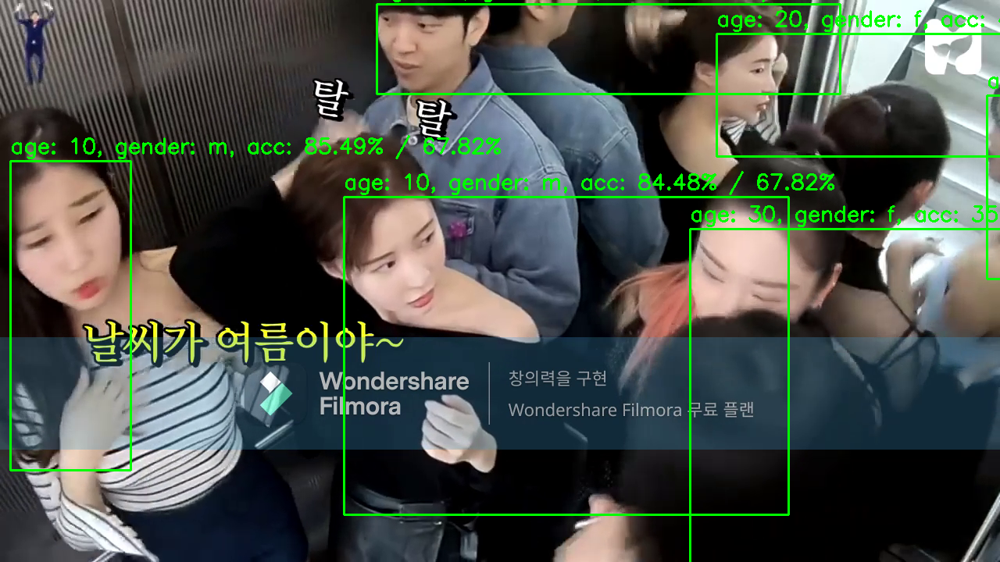


0: 544x960 6 faces, 44.9ms
Speed: 3.9ms preprocess, 44.9ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


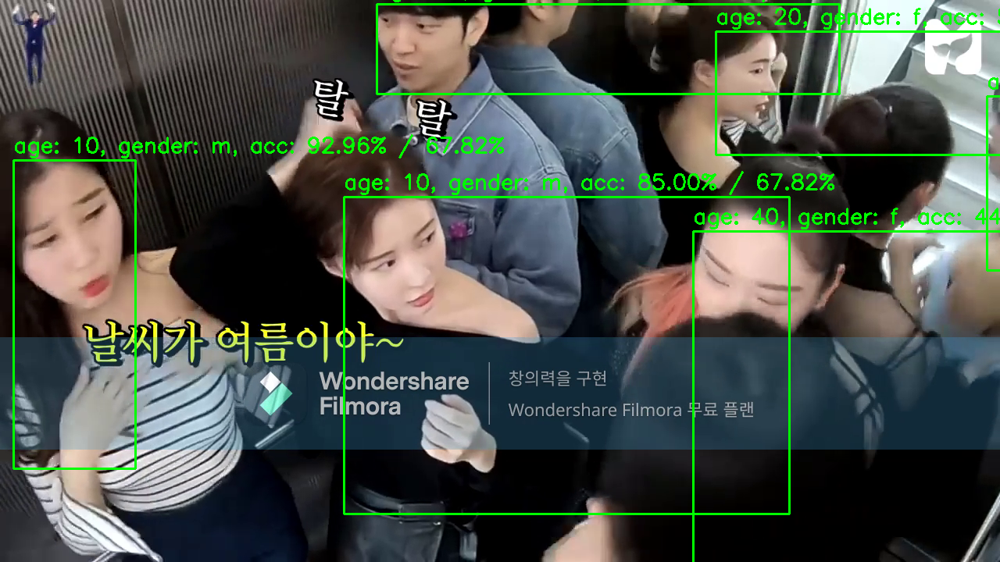


0: 544x960 6 faces, 44.7ms
Speed: 4.2ms preprocess, 44.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


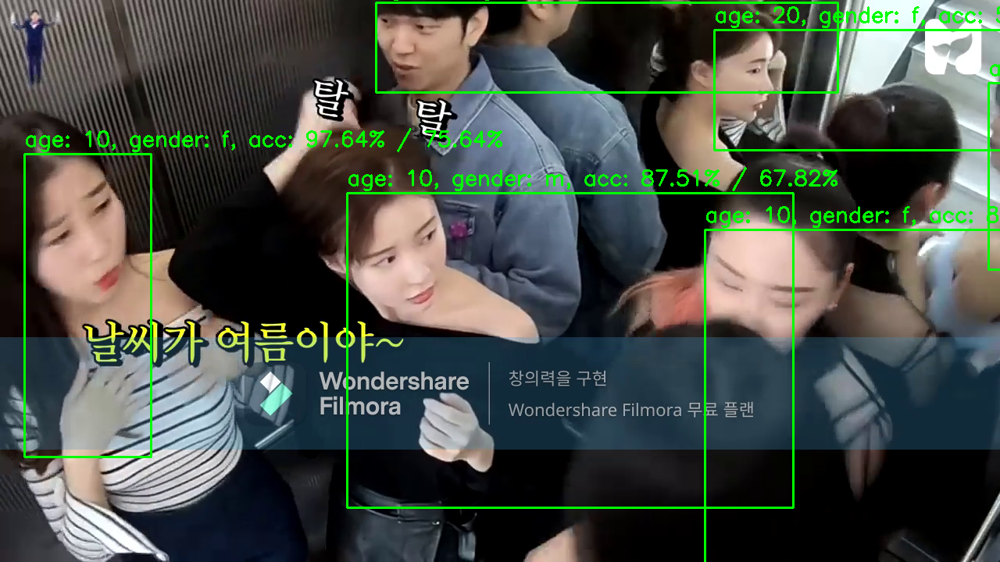


0: 544x960 6 faces, 44.9ms
Speed: 5.4ms preprocess, 44.9ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


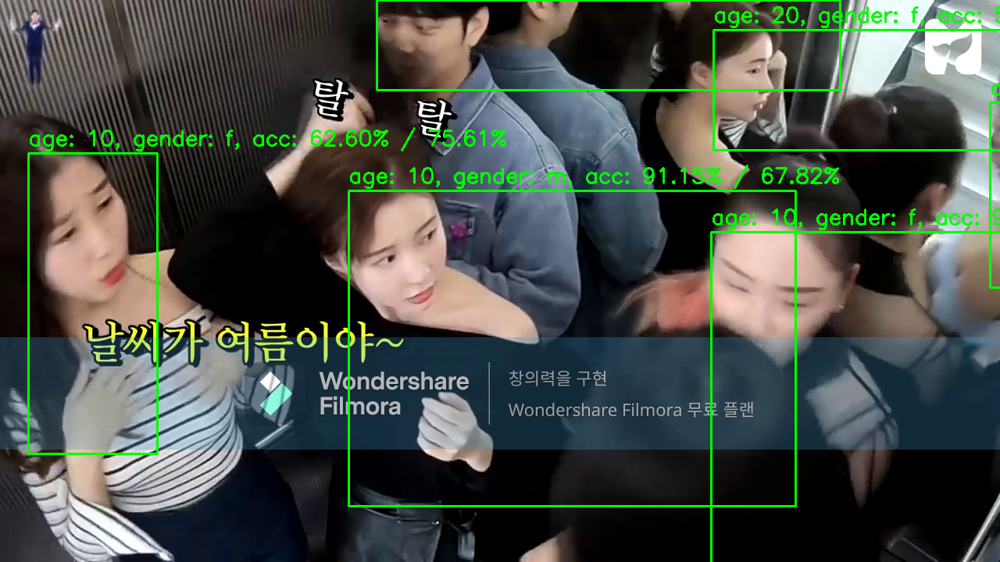


0: 544x960 7 faces, 44.7ms
Speed: 4.0ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


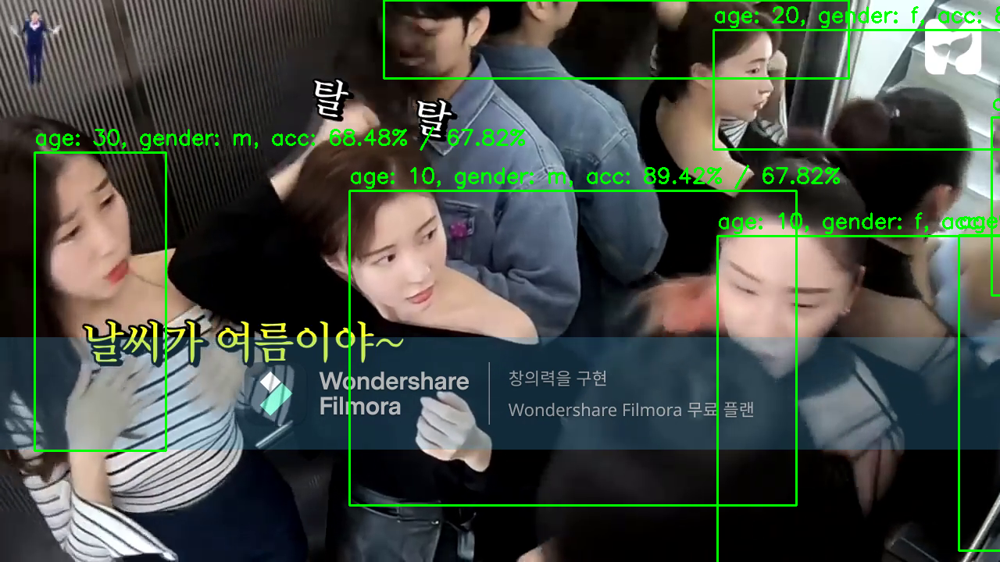


0: 544x960 5 faces, 44.7ms
Speed: 4.9ms preprocess, 44.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


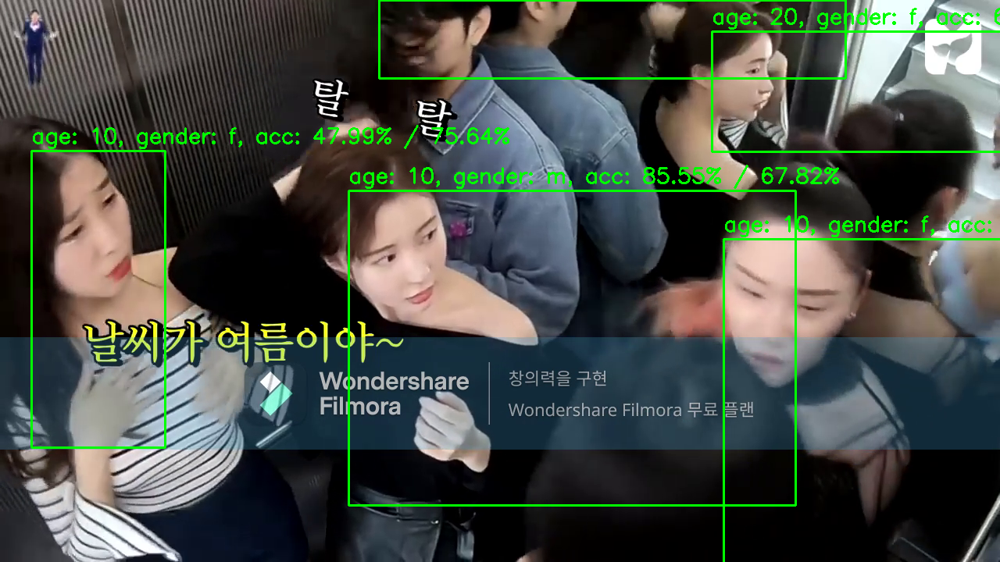


0: 544x960 7 faces, 44.8ms
Speed: 5.2ms preprocess, 44.8ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


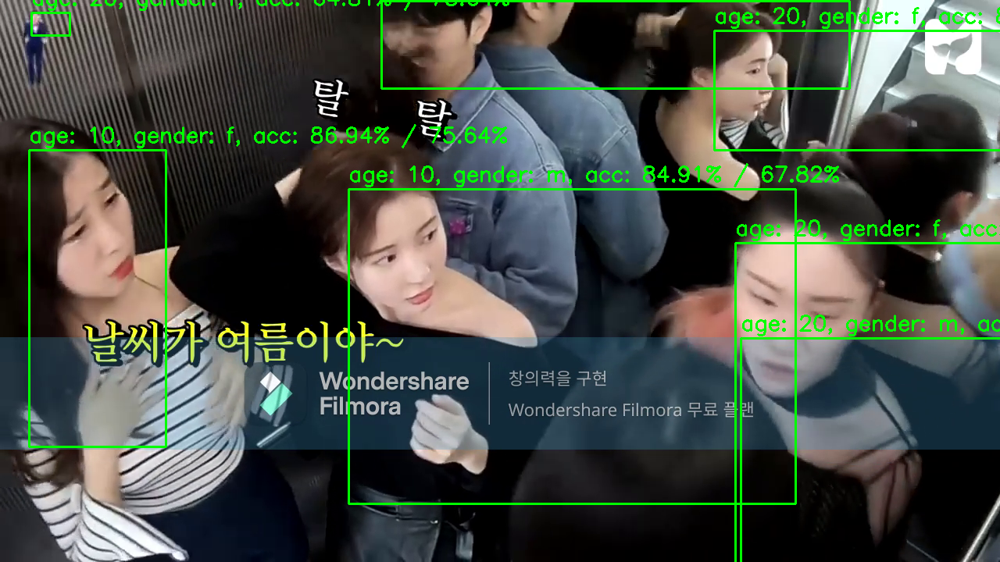


0: 544x960 7 faces, 44.8ms
Speed: 4.3ms preprocess, 44.8ms inference, 2.4ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 23ms/step


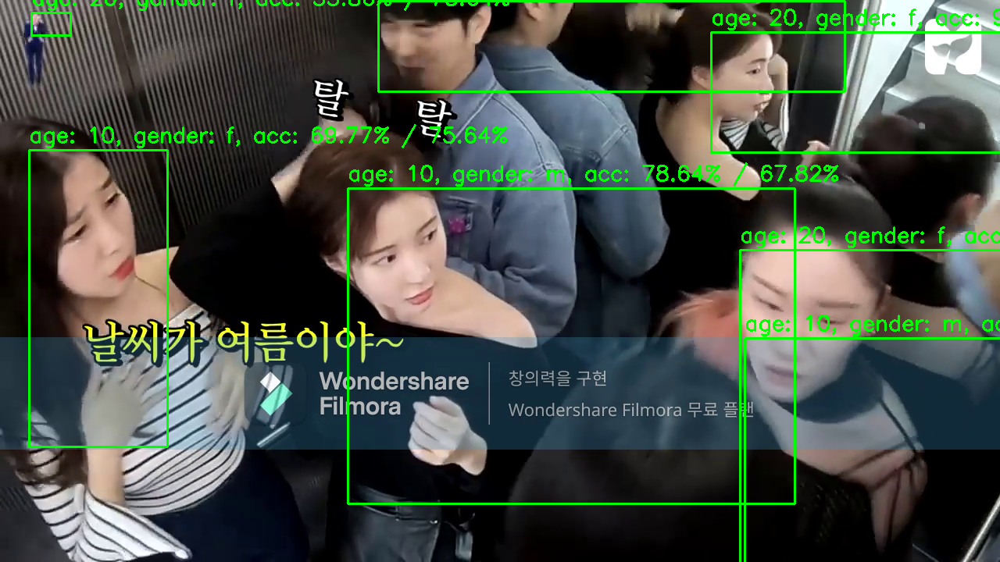


0: 544x960 6 faces, 44.7ms
Speed: 3.8ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


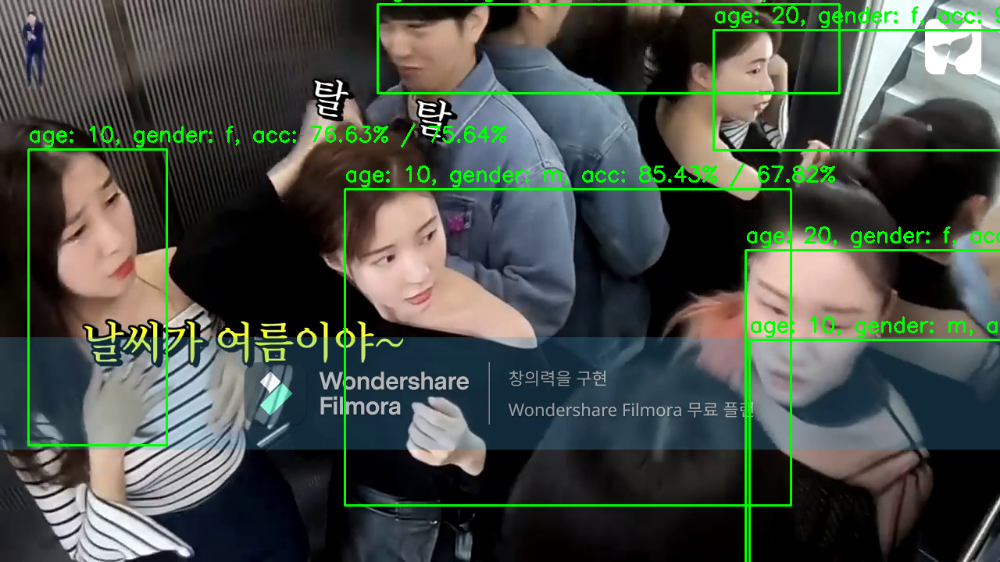


0: 544x960 6 faces, 44.7ms
Speed: 3.8ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


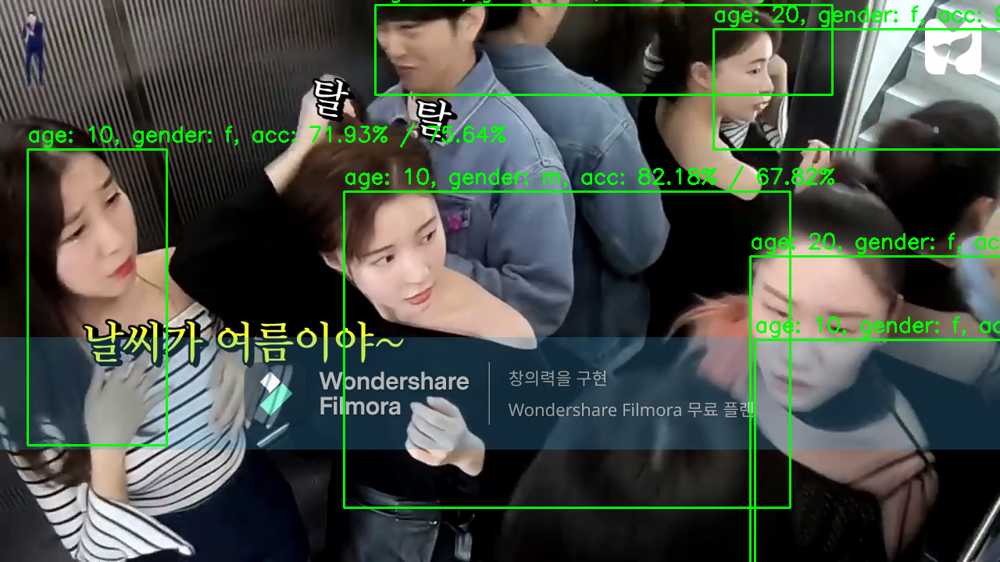


0: 544x960 6 faces, 44.7ms
Speed: 4.2ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


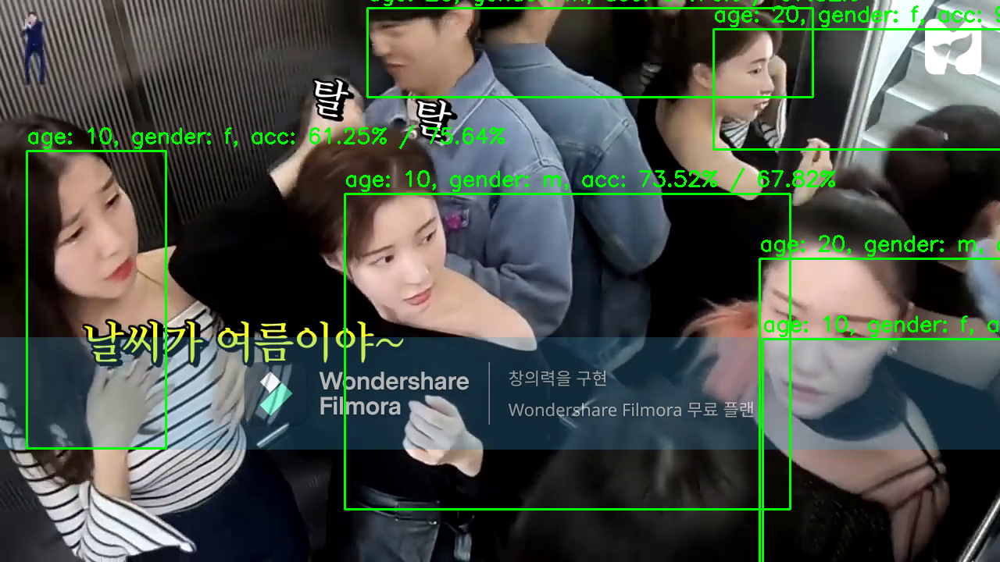


0: 544x960 6 faces, 44.7ms
Speed: 4.0ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


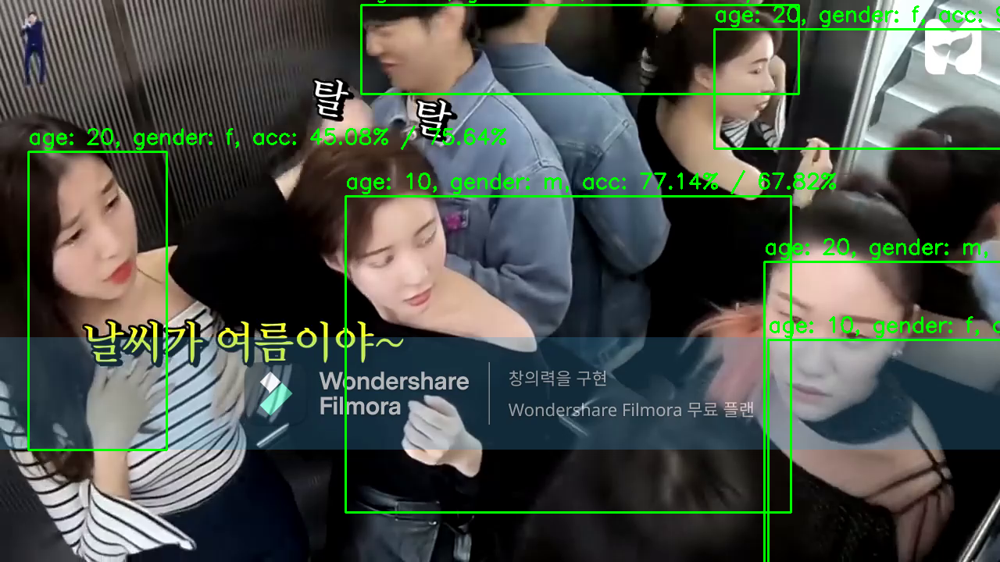


0: 544x960 6 faces, 44.7ms
Speed: 5.6ms preprocess, 44.7ms inference, 2.6ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


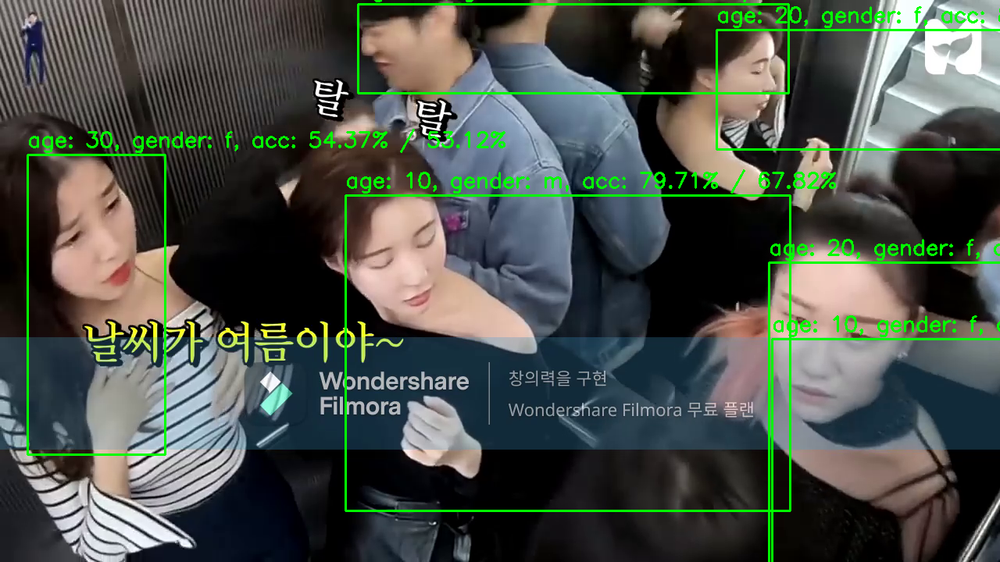


0: 544x960 6 faces, 44.7ms
Speed: 3.8ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


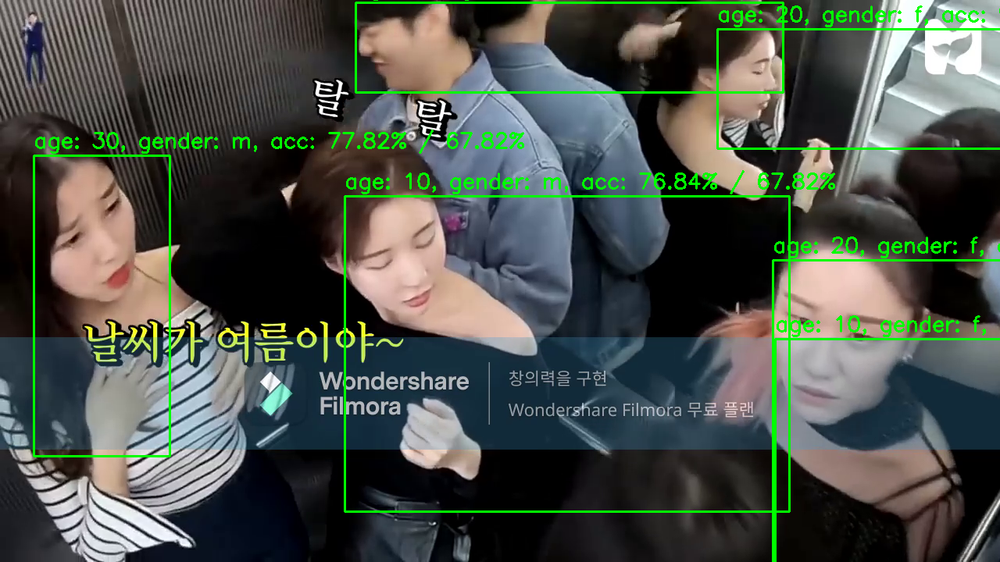


0: 544x960 7 faces, 44.7ms
Speed: 5.9ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


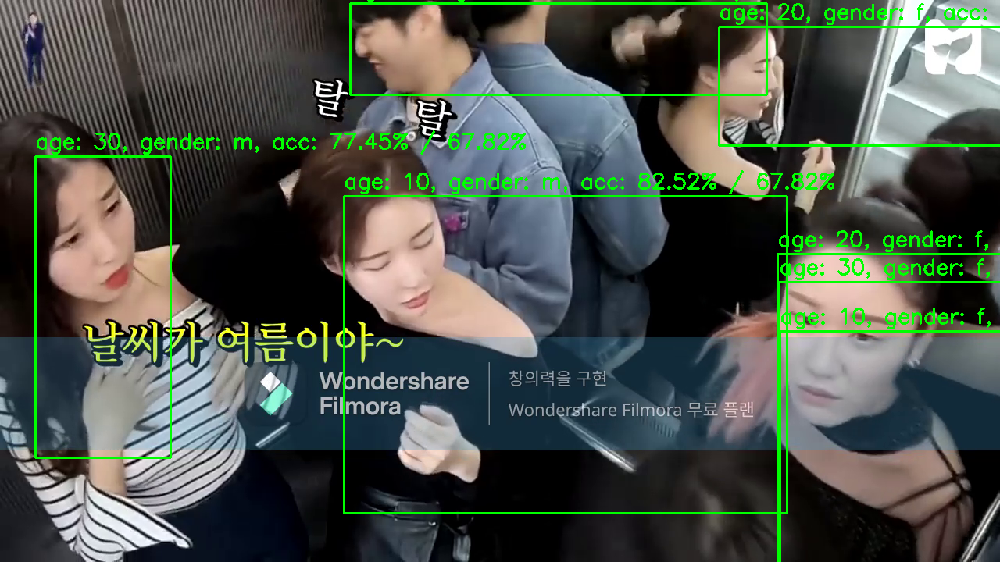


0: 544x960 6 faces, 44.9ms
Speed: 5.6ms preprocess, 44.9ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 22ms/step


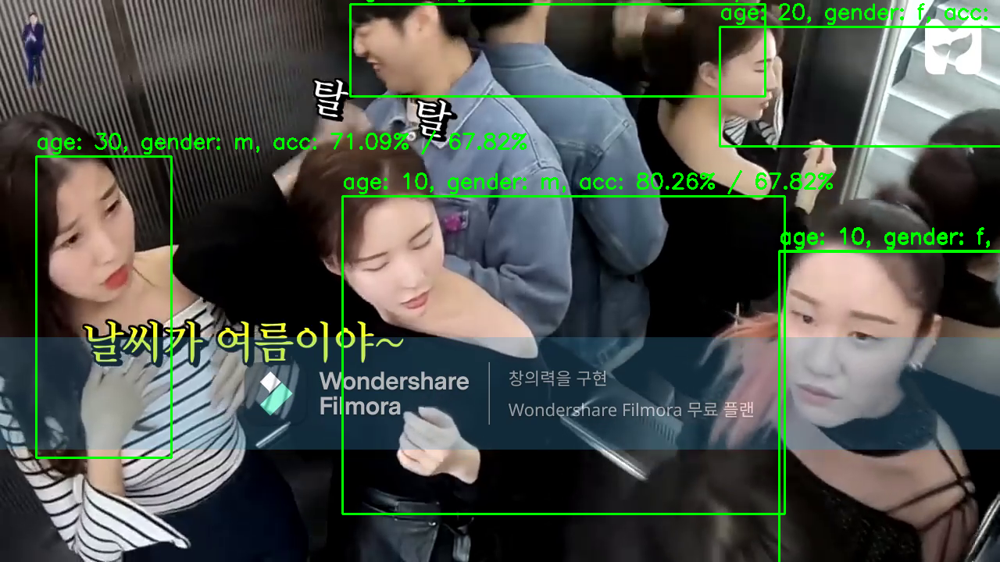


0: 544x960 7 faces, 44.8ms
Speed: 5.4ms preprocess, 44.8ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


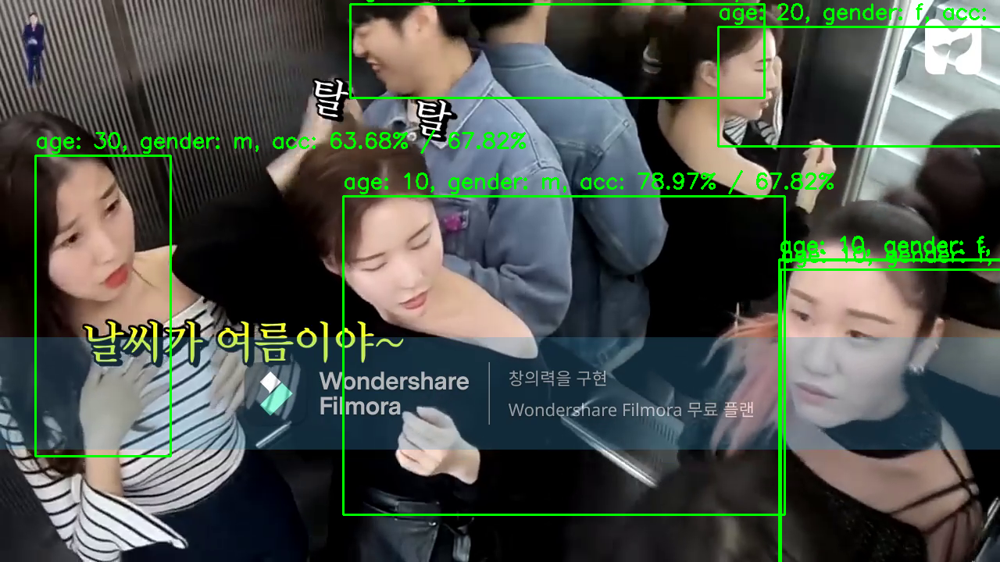


0: 544x960 5 faces, 44.7ms
Speed: 3.8ms preprocess, 44.7ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


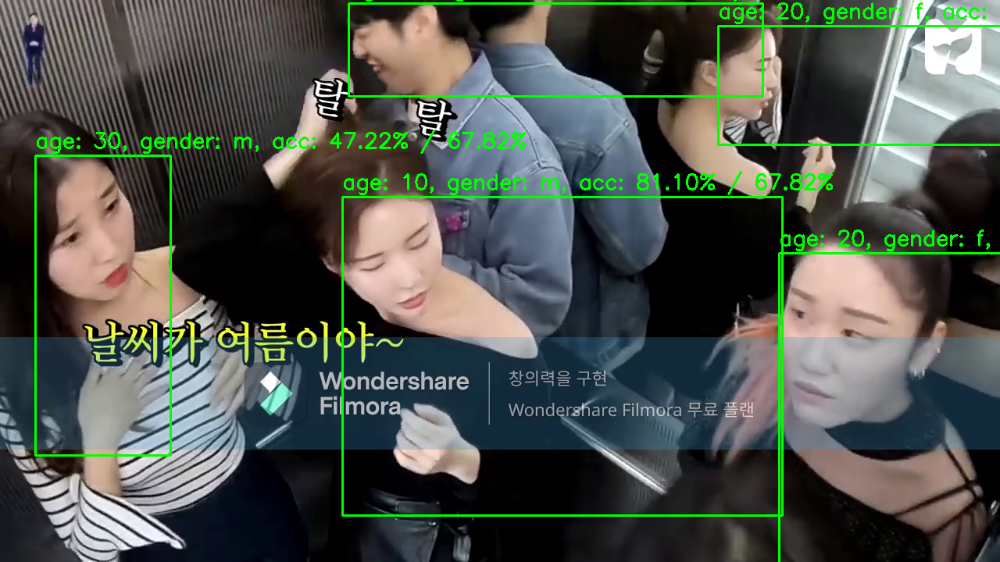


0: 544x960 5 faces, 44.8ms
Speed: 3.9ms preprocess, 44.8ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


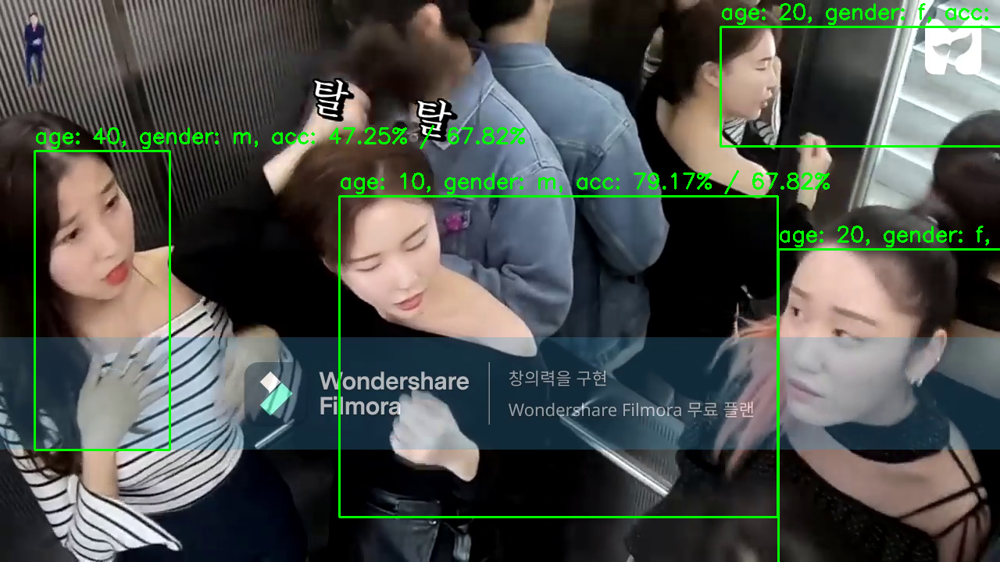


0: 544x960 5 faces, 45.0ms
Speed: 5.6ms preprocess, 45.0ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


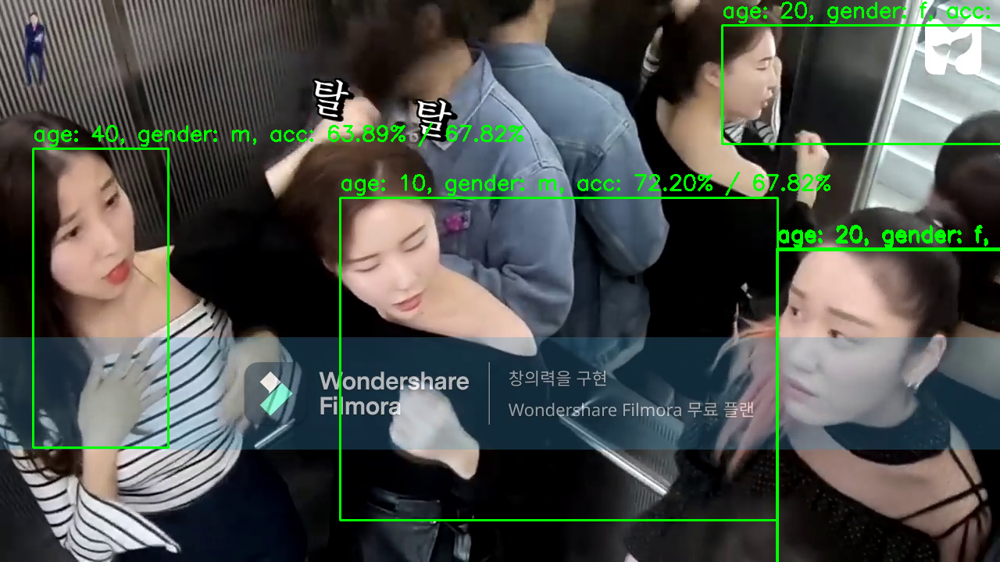


0: 544x960 5 faces, 45.1ms
Speed: 5.7ms preprocess, 45.1ms inference, 1.7ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


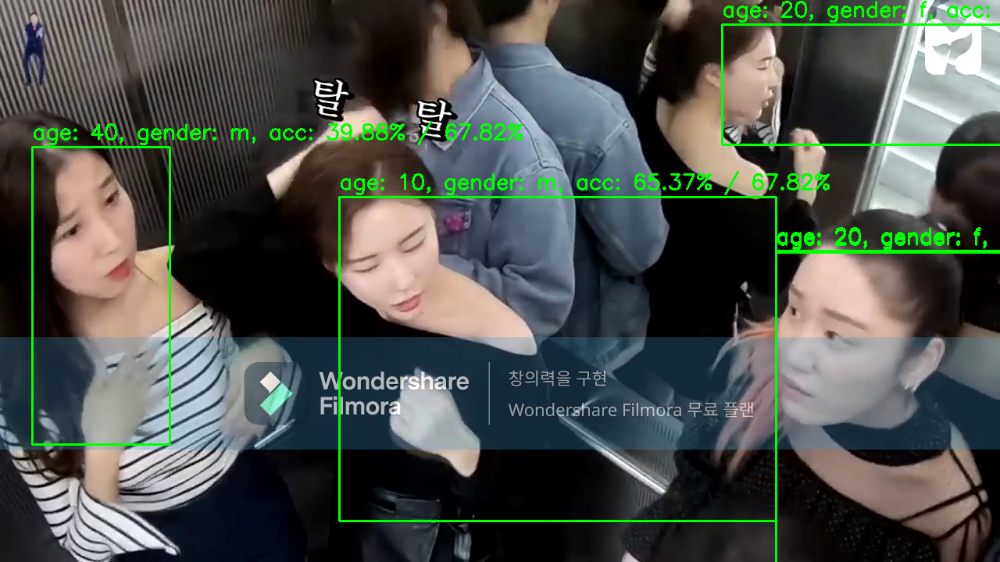


0: 544x960 7 faces, 45.1ms
Speed: 5.7ms preprocess, 45.1ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


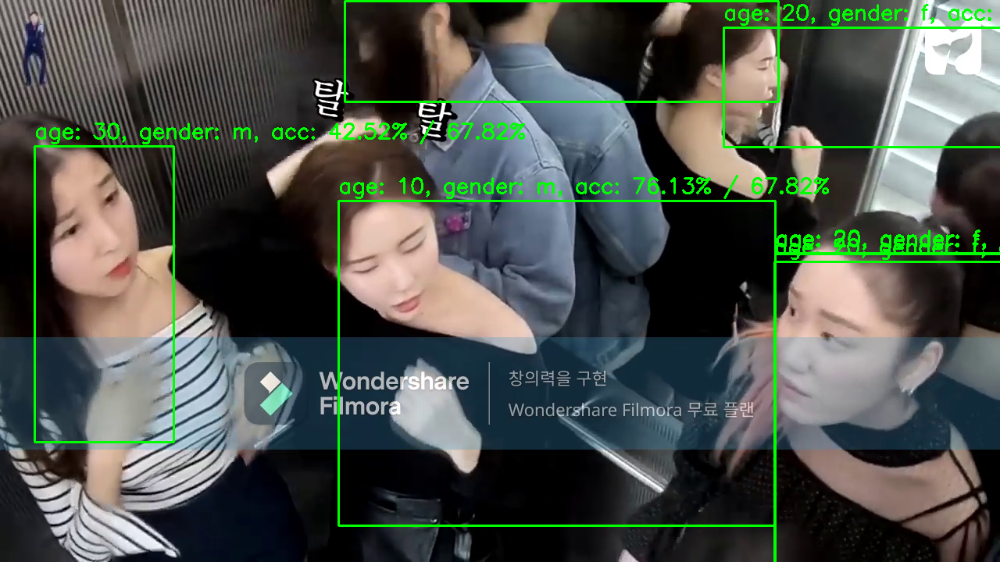


0: 544x960 6 faces, 45.3ms
Speed: 3.8ms preprocess, 45.3ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 20ms/step


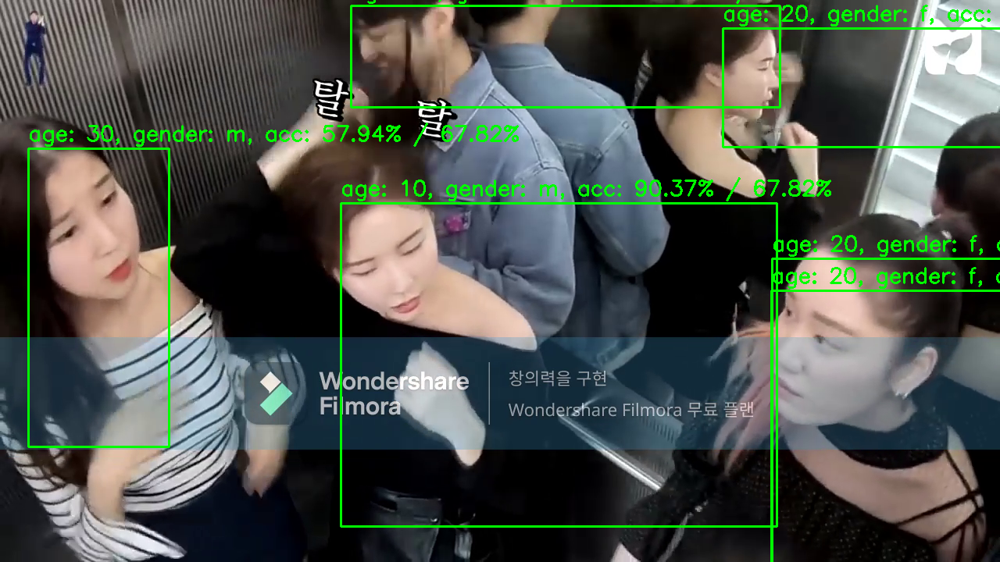


0: 544x960 6 faces, 44.7ms
Speed: 5.5ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 21ms/step


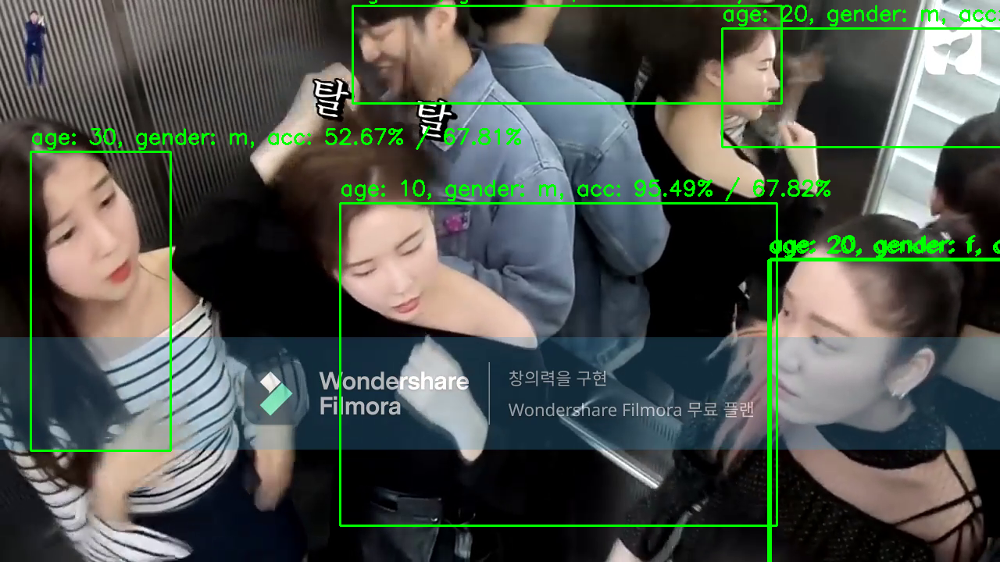


0: 544x960 6 faces, 44.7ms
Speed: 5.7ms preprocess, 44.7ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 960)
1/1 [==============================] - 0s 23ms/step


In [ ]:

import cv2
import numpy as np
from keras.models import load_model
from keras.preprocessing.image import img_to_array
from keras.applications.mobilenet_v2 import preprocess_input
from google.colab.patches import cv2_imshow
from ultralytics import YOLO


# 모델 로드
face_model = YOLO("./model/yolov8m-face_0/yolov8m-face.pt")  # 얼굴 검출 모델 로드
age_model = load_model('./model/model1048_05_0.481.hdf5')  # 나이 모델 로드
gender_model = load_model('./model/model2_02_0.854.hdf5')  # 성별 모델 로드


# 이미지 전처리
def preprocess_image(image):
    image = cv2.resize(image, (224, 224))
    image = img_to_array(image)
    image = preprocess_input(image)
    image = np.expand_dims(image, axis=0)
    return image


# 나이 예측 모델
def predict_age(model, input_image):
    # 예측을 위해 이미지를 적절한 형식으로 전처리
    input_image = preprocess_image(input_image)

    # 모델에 이미지 전달하여 예측 수행
    age_prediction = model.predict(input_image)

    # 예측 결과 반환
    return age_prediction


# 성별 예측 모델
def predict_gender(model, input_image):
    input_image = preprocess_image(input_image)
    gender_prediction = model.predict(input_image)
    return gender_prediction

# 미디어 파이프
def detect_face_and_count_eyes(frame, required_front_facing_time=3):
    global count, front_facing_time  # count와 front_facing_time이 글로벌 변수임을 나타내는 부분
    mp_face_mesh = mp.solutions.face_mesh
    mp_drawing = mp.solutions.drawing_utils
    drawing_spec = mp_drawing.DrawingSpec(thickness=1, circle_radius=1)
    static_image_mode = False
    max_num_faces = 10
    refine_landmarks = False
    min_detection_confidence = 0.2

    # 얼굴 메시 감지 수행
    with mp_face_mesh.FaceMesh(static_image_mode=static_image_mode,
                                max_num_faces=max_num_faces,
                                refine_landmarks=refine_landmarks,
                                min_detection_confidence=min_detection_confidence) as face_mesh:
        # 얼굴 메시 감지 결과 반환
        results = face_mesh.process(frame)

        # 얼굴 메시 그리기
        if results.multi_face_landmarks:
            for face_landmarks in results.multi_face_landmarks:
                # 눈 내부의 특정 지점을 찾기 위해 눈 부분의 좌표를 사용
                left_eye_x = face_landmarks.landmark[159].x  # 눈 내부 지점의 인덱스는 159입니다.
                right_eye_x = face_landmarks.landmark[386].x  # 눈 내부 지점의 인덱스는 386입니다.
                is_front_facing = abs(left_eye_x - right_eye_x) < 0.15  # 임계값은 상황에 따라 조정 가능

                # 얼굴이 정면을 향하면 front_facing_time 증가
                if is_front_facing:
                    front_facing_time += 1
                else:
                    front_facing_time = 0

                # 정면을 향한 상태를 유지하는 시간이 필요한 시간 이상인지 확인
                if front_facing_time >= required_front_facing_time * 30:  # 초 단위를 프레임 단위로 변환
                    print("{} 초 동안 정면을 향함. Count가 증가함.".format(required_front_facing_time))
                    count += 1
                    front_facing_time = 0

    return count


# 카메라 열기 (CCTV 영상 대신 카메라를 사용할 수도 있음)
cap = cv2.VideoCapture('./model/cctv2.mp4')  # CCTV 영상 파일 경로 입력


# mesh
is_front_facing = False
front_facing_time = 0
count = 0

# 동영상 재생
while True:
    ret, frame = cap.read()

    # 얼굴 감지
    results = face_model(frame)

    resultT = results[0].boxes.data.cpu().numpy()

    for box in resultT[:, :4]:
        x, y, w, h = map(int, box)


        # 추출된 얼굴 영역
        face_image = frame[y:y+h, x:x+w]

        # 눈을 통한 정면 감지 및 카운트 수행
        count = detect_face_and_count_eyes(frame)

        # 나이 예측
        age_predictions = predict_age(age_model, face_image)
        predicted_age_index = np.argmax(age_predictions)
        predicted_age = predicted_age_index * 10 + 10  # 인덱스를 나이로 변환
        age_accuracy = np.max(age_predictions)  # 나이 예측 정확도

        # 성별 예측
        gender_predictions = predict_gender(gender_model, face_image)
        predicted_gender_index = np.argmax(gender_predictions)
        gender_accuracy = np.max(gender_predictions)  # 성별 예측 정확도

        # 얼굴에 박스 그리기
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # 나이 및 성별 출력
        predicted_gender = 'f' if predicted_gender_index == 0 else 'm'
        text = f"age: {predicted_age}, gender: {predicted_gender}, acc: {age_accuracy * 100:.2f}% / {gender_accuracy * 100:.2f}%"
        cv2.putText(frame, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

    # 화면에 표시
    cv2_imshow(frame)

    # 종료 키: 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 작업 완료 후 해제
cap.release()
cv2.destroyAllWindows()